In [1]:
import pandas as pd
import yaml
import matplotlib.pyplot as plt
import numpy as np
%matplotlib inline


In [2]:
try:
    with open (r"config.yaml",'r') as file:
        config=yaml.safe_load(file)
except Exception as p:
    print("Error reading the config file")

In [3]:
df_final_demo=pd.read_csv(config["data"]["final_demo"])
df_experiment_clients=pd.read_csv(config["data"]["final_experiment"])
df_pt1=pd.read_csv(config["data"]["pt1"])
df_pt2=pd.read_csv(config["data"]["pt2"])

In [4]:
df_experiment_clients.head()

,client_id,Variation
0,9988021,Test
1,8320017,Test
2,4033851,Control
3,1982004,Test
4,9294070,Control


In [5]:
df_experiment_clients["Variation"].value_counts()

Variation
Test       26968
Control    23532
Name: count, dtype: int64

In [6]:
df_experiment_clients.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 70609 entries, 0 to 70608
Data columns (total 2 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   client_id  70609 non-null  int64 
 1   Variation  50500 non-null  object
dtypes: int64(1), object(1)
memory usage: 1.1+ MB


In [7]:
df_pt1.head()

,client_id,visitor_id,visit_id,process_step,date_time
0,9988021,580560515_7732621733,781255054_21935453173_531117,step_3,2017-04-17 15:27:07
1,9988021,580560515_7732621733,781255054_21935453173_531117,step_2,2017-04-17 15:26:51
2,9988021,580560515_7732621733,781255054_21935453173_531117,step_3,2017-04-17 15:19:22
3,9988021,580560515_7732621733,781255054_21935453173_531117,step_2,2017-04-17 15:19:13
4,9988021,580560515_7732621733,781255054_21935453173_531117,step_3,2017-04-17 15:18:04


In [8]:
df_pt2.head(10)

,client_id,visitor_id,visit_id,process_step,date_time
0,763412,601952081_10457207388,397475557_40440946728_419634,confirm,2017-06-06 08:56:00
1,6019349,442094451_91531546617,154620534_35331068705_522317,confirm,2017-06-01 11:59:27
2,6019349,442094451_91531546617,154620534_35331068705_522317,step_3,2017-06-01 11:58:48
3,6019349,442094451_91531546617,154620534_35331068705_522317,step_2,2017-06-01 11:58:08
4,6019349,442094451_91531546617,154620534_35331068705_522317,step_1,2017-06-01 11:57:58
5,6019349,442094451_91531546617,154620534_35331068705_522317,start,2017-06-01 11:57:54
6,4726500,934350987_45569789638,467318052_88159801968_565608,confirm,2017-06-05 17:38:52
7,4726500,934350987_45569789638,467318052_88159801968_565608,step_3,2017-06-05 17:38:33
8,4726500,934350987_45569789638,467318052_88159801968_565608,step_2,2017-06-05 17:37:31
9,4726500,934350987_45569789638,467318052_88159801968_565608,step_1,2017-06-05 17:37:24


In [9]:
df_visitas=pd.concat([df_pt1, df_pt2], axis=0, ignore_index=True)

In [10]:
df_visitas.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 755405 entries, 0 to 755404
Data columns (total 5 columns):
 #   Column        Non-Null Count   Dtype 
---  ------        --------------   ----- 
 0   client_id     755405 non-null  int64 
 1   visitor_id    755405 non-null  object
 2   visit_id      755405 non-null  object
 3   process_step  755405 non-null  object
 4   date_time     755405 non-null  object
dtypes: int64(1), object(4)
memory usage: 28.8+ MB


In [11]:
# Eliminar filas que tienen NaN en todas las columnas excepto en 'client_id'
# Se borran filas ya que las mismas solo tenian el client id y ningun dato mas
df_final_demo = df_final_demo[~(df_final_demo.drop(columns=['client_id']).isna().all(axis=1))]





In [12]:
frequency_table = df_visitas['process_step'].value_counts()

In [13]:
frequency_table

process_step
start      243945
step_1     163193
step_2     133062
step_3     112242
confirm    102963
Name: count, dtype: int64

In [14]:
frequency_table.describe()

count         5.00000
mean     151081.00000
std       56830.70747
min      102963.00000
25%      112242.00000
50%      133062.00000
75%      163193.00000
max      243945.00000
Name: count, dtype: float64

In [15]:
# Convertir la columna 'time' a datetime
df_visitas['date_time'] = pd.to_datetime(df_visitas['date_time'], format="%Y-%m-%d %H:%M:%S")

In [16]:
df_visitas.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 755405 entries, 0 to 755404
Data columns (total 5 columns):
 #   Column        Non-Null Count   Dtype         
---  ------        --------------   -----         
 0   client_id     755405 non-null  int64         
 1   visitor_id    755405 non-null  object        
 2   visit_id      755405 non-null  object        
 3   process_step  755405 non-null  object        
 4   date_time     755405 non-null  datetime64[ns]
dtypes: datetime64[ns](1), int64(1), object(3)
memory usage: 28.8+ MB


In [17]:
# Ordenar por 'visitor_id' y 'date_time' para calcular diferencias secuenciales
df_visitas = df_visitas.sort_values(by=['visitor_id', 'date_time'])

# Calcular el tiempo entre pasos
df_visitas['time_in_step'] = (
    df_visitas.groupby('visit_id')['date_time'].shift(-1) - df_visitas['date_time']
).dt.total_seconds()

In [18]:
# Contar cuántas filas tienen 'time_in_step' menor o igual a 2
count_values = (df_visitas['time_in_step'] <= 2).sum()

# Mostrar el resultado
print(count_values)

"""Se eliminan 21487 datos que se consideran errores por estar menos de 2 segundos en la etapa del proceso"""
#df_visitas = df_visitas[df_visitas['time_in_step'] > 2]



21487


'Se eliminan 21487 datos que se consideran errores por estar menos de 2 segundos en la etapa del proceso'

In [19]:


# Paso 2: Crear la columna 'failure' (consideramos fallo si 'time_in_step' < 2, pero ahora ya no debería haber)
df_visitas['failure'] = (df_visitas['time_in_step'] < 2).astype(int) #and Y  agregar masd filtros

# Paso 3: Agrupar por 'visit_id' y calcular el promedio de 'failure' para obtener la tasa de fallos
df_visitas_grouped = df_visitas.groupby('visit_id').agg(
    failure_rate=('failure', 'mean')
).reset_index()

# Paso 4: Agregar la columna 'failure_rate' al DataFrame original
df_visitas = df_visitas.merge(df_visitas_grouped[['visit_id', 'failure_rate']], on='visit_id', how='left')

# Paso 5: Ver el DataFrame con la nueva columna 'failure_rate'
print(df_visitas.head())


   client_id             visitor_id                      visit_id  \
0    5867343  100011869_84756704576  406596333_52561114200_989487   
1    5867343  100011869_84756704576  406596333_52561114200_989487   
2    5867343  100011869_84756704576  406596333_52561114200_989487   
3    5867343  100011869_84756704576  406596333_52561114200_989487   
4    5867343  100011869_84756704576  406596333_52561114200_989487   

  process_step           date_time  time_in_step  failure  failure_rate  
0        start 2017-06-05 02:47:42           5.0        0           0.0  
1       step_1 2017-06-05 02:47:47          16.0        0           0.0  
2       step_2 2017-06-05 02:48:03         135.0        0           0.0  
3       step_3 2017-06-05 02:50:18          53.0        0           0.0  
4        start 2017-06-05 02:51:11           NaN        0           0.0  


In [20]:
# Contar cuántas veces ocurre cada paso para cada visitor_id
count_steps = df_visitas.groupby(['client_id', 'visitor_id', 'visit_id', 'process_step']).size().reset_index(name='count')

# Mostrar el resultado
count_steps


,client_id,visitor_id,visit_id,process_step,count
0,169,201385055_71273495308,749567106_99161211863_557568,confirm,1
1,169,201385055_71273495308,749567106_99161211863_557568,start,1
2,169,201385055_71273495308,749567106_99161211863_557568,step_1,1
3,169,201385055_71273495308,749567106_99161211863_557568,step_2,1
4,169,201385055_71273495308,749567106_99161211863_557568,step_3,1
...,...,...,...,...,...
557609,9999875,738878760_1556639849,931268933_219402947_599432,confirm,1
557610,9999875,738878760_1556639849,931268933_219402947_599432,start,1
557611,9999875,738878760_1556639849,931268933_219402947_599432,step_1,2
557612,9999875,738878760_1556639849,931268933_219402947_599432,step_2,1


In [21]:
# Hacer merge con el DataFrame original
df_visitas_with_counts = pd.merge(df_visitas, count_steps, on=['visit_id', 'process_step'], how='left')

# Mostrar el resultado final
df_visitas_with_counts

,client_id_x,visitor_id_x,visit_id,process_step,date_time,time_in_step,failure,failure_rate,client_id_y,visitor_id_y,count
0,5867343,100011869_84756704576,406596333_52561114200_989487,start,2017-06-05 02:47:42,5.0,0,0.0,5867343,100011869_84756704576,2
1,5867343,100011869_84756704576,406596333_52561114200_989487,step_1,2017-06-05 02:47:47,16.0,0,0.0,5867343,100011869_84756704576,1
2,5867343,100011869_84756704576,406596333_52561114200_989487,step_2,2017-06-05 02:48:03,135.0,0,0.0,5867343,100011869_84756704576,1
3,5867343,100011869_84756704576,406596333_52561114200_989487,step_3,2017-06-05 02:50:18,53.0,0,0.0,5867343,100011869_84756704576,1
4,5867343,100011869_84756704576,406596333_52561114200_989487,start,2017-06-05 02:51:11,NaN,0,0.0,5867343,100011869_84756704576,2
...,...,...,...,...,...,...,...,...,...,...,...
765958,7042750,999998529_89539814462,583327415_19513940564_488564,step_2,2017-04-12 11:55:05,8.0,0,0.0,7042750,999998529_89539814462,2
765959,7042750,999998529_89539814462,583327415_19513940564_488564,step_3,2017-04-12 11:55:13,574.0,0,0.0,7042750,999998529_89539814462,2
765960,7042750,999998529_89539814462,583327415_19513940564_488564,confirm,2017-04-12 12:04:47,282.0,0,0.0,7042750,999998529_89539814462,1
765961,7042750,999998529_89539814462,583327415_19513940564_488564,start,2017-04-12 12:09:29,18.0,0,0.0,7042750,999998529_89539814462,2


In [22]:
# Obtener el tiempo promedio en cada paso para cada visitor_id
time_steps = df_visitas.groupby(['client_id', 'visitor_id', 'visit_id', 'process_step', 'failure_rate'])['time_in_step'].mean().reset_index(name='avg_time_in_step')

# Mostrar el resultado de los tiempos
time_steps

,client_id,visitor_id,visit_id,process_step,failure_rate,avg_time_in_step
0,169,201385055_71273495308,749567106_99161211863_557568,confirm,0.0,NaN
1,169,201385055_71273495308,749567106_99161211863_557568,start,0.0,9.0
2,169,201385055_71273495308,749567106_99161211863_557568,step_1,0.0,46.0
3,169,201385055_71273495308,749567106_99161211863_557568,step_2,0.0,94.0
4,169,201385055_71273495308,749567106_99161211863_557568,step_3,0.0,64.0
...,...,...,...,...,...,...
557609,9999875,738878760_1556639849,931268933_219402947_599432,confirm,0.0,NaN
557610,9999875,738878760_1556639849,931268933_219402947_599432,start,0.0,7.0
557611,9999875,738878760_1556639849,931268933_219402947_599432,step_1,0.0,49.5
557612,9999875,738878760_1556639849,931268933_219402947_599432,step_2,0.0,191.0


In [23]:
# Hacer un merge entre los conteos y los tiempos
df_visitas_final = pd.merge(count_steps, time_steps, on=['client_id', 'visitor_id', 'visit_id', 'process_step'], how='left')

# Mostrar el resultado final
df_visitas_final


,client_id,visitor_id,visit_id,process_step,count,failure_rate,avg_time_in_step
0,169,201385055_71273495308,749567106_99161211863_557568,confirm,1,0.0,NaN
1,169,201385055_71273495308,749567106_99161211863_557568,start,1,0.0,9.0
2,169,201385055_71273495308,749567106_99161211863_557568,step_1,1,0.0,46.0
3,169,201385055_71273495308,749567106_99161211863_557568,step_2,1,0.0,94.0
4,169,201385055_71273495308,749567106_99161211863_557568,step_3,1,0.0,64.0
...,...,...,...,...,...,...,...
557609,9999875,738878760_1556639849,931268933_219402947_599432,confirm,1,0.0,NaN
557610,9999875,738878760_1556639849,931268933_219402947_599432,start,1,0.0,7.0
557611,9999875,738878760_1556639849,931268933_219402947_599432,step_1,2,0.0,49.5
557612,9999875,738878760_1556639849,931268933_219402947_599432,step_2,1,0.0,191.0


In [24]:
# Agrupar
df_visitas_grouped = df_visitas_final.groupby(['client_id','visitor_id', 'visit_id', 'process_step'], as_index=False).agg(
    count=('count', 'sum'),
    avg_time_in_step=('avg_time_in_step', 'mean')
)

# Crear la tabla pivote para los conteos
pivot_count = df_visitas_grouped.pivot_table(
    index='visit_id', 
    columns='process_step', 
    values='count', 
    aggfunc='sum', 
    fill_value=0
)

# Renombrar las columnas para que incluyan el nombre del `process_step` y el sufijo "count"
pivot_count.columns = [f'{col}_count' for col in pivot_count.columns]

# Crear la tabla pivote para los tiempos
pivot_time = df_visitas_grouped.pivot_table(
    index='visit_id', 
    columns='process_step', 
    values='avg_time_in_step', 
    aggfunc='mean', 
    fill_value=0
)

# Renombrar las columnas para que incluyan el nombre del `process_step` y el sufijo "time"
pivot_time.columns = [f'{col}_time' for col in pivot_time.columns]

# Unir ambas tablas
df_pivot_final = pd.concat([pivot_count, pivot_time], axis=1)

# Ahora agrega visit_id y client_id al DataFrame final usando `merge`
df_pivot_final = df_pivot_final.reset_index()
df_pivot_final = df_pivot_final.merge(df_visitas_final[['client_id', 'visitor_id', 'visit_id', 'failure_rate']].drop_duplicates(), on='visit_id', how='left')

# Mostrar el DataFrame final con los conteos, tiempos y visit_id y client_id
df_pivot_final


,visit_id,confirm_count,start_count,step_1_count,step_2_count,step_3_count,confirm_time,start_time,step_1_time,step_2_time,step_3_time,client_id,visitor_id,failure_rate
0,100012776_37918976071_457913,2,0,0,0,0,52.0,0.000000,0.00,0.0,0.0,3561384,451664975_1722933822,0.0
1,1000165_4190026492_760066,1,1,1,1,1,0.0,3.000000,24.00,77.0,37.0,9056452,306992881_89423906595,0.0
2,100019538_17884295066_43909,1,3,4,2,1,0.0,11.666667,5.75,63.5,57.0,7338123,612065484_94198474375,0.0
3,100022086_87870757897_149620,1,1,1,1,1,0.0,22.000000,45.00,53.0,60.0,2478628,754122351_18568832435,0.0
4,100030127_47967100085_936361,0,1,0,0,0,NaN,NaN,NaN,NaN,NaN,105007,676020267_36602664238,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
159107,999986292_55082159911_561557,2,0,0,0,0,1895.0,0.000000,0.00,0.0,0.0,8374531,339629093_15796635997,0.0
159108,999988789_76411676596_272843,0,2,2,1,0,0.0,11.000000,31.50,44.0,0.0,6627522,730634087_44272418812,0.0
159109,999989069_52203656268_170206,0,1,1,0,0,0.0,4.000000,0.00,0.0,0.0,3735489,614972736_12303688756,0.0
159110,999991142_15352368745_399725,0,1,0,0,0,NaN,NaN,NaN,NaN,NaN,3761538,522028589_37033306085,0.0


In [32]:
# Realizar el primer merge entre df_pivot_final y df_final_demo usando 'client_id'
df_merged_1 = pd.merge(df_pivot_final, df_final_demo, on='client_id', how='left')

# Realizar el segundo merge entre el resultado anterior y df_experiment_clients usando 'client_id'
df_merged_final = pd.merge(df_merged_1, df_experiment_clients, on='client_id', how='left')

pd.set_option('display.max_columns', None)
# Mostrar el DataFrame final con los merges realizados
df_merged_final


,visit_id,confirm_count,start_count,step_1_count,step_2_count,step_3_count,confirm_time,start_time,step_1_time,step_2_time,step_3_time,client_id,visitor_id,failure_rate,clnt_tenure_yr,clnt_tenure_mnth,clnt_age,gendr,num_accts,bal,calls_6_mnth,logons_6_mnth,Variation
0,100012776_37918976071_457913,2,0,0,0,0,52.0,0.000000,0.00,0.0,0.0,3561384,451664975_1722933822,0.0,4.0,56.0,59.5,U,2.0,63130.44,6.0,9.0,Test
1,1000165_4190026492_760066,1,1,1,1,1,0.0,3.000000,24.00,77.0,37.0,9056452,306992881_89423906595,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,100019538_17884295066_43909,1,3,4,2,1,0.0,11.666667,5.75,63.5,57.0,7338123,612065484_94198474375,0.0,7.0,88.0,23.5,M,2.0,26436.73,6.0,9.0,Test
3,100022086_87870757897_149620,1,1,1,1,1,0.0,22.000000,45.00,53.0,60.0,2478628,754122351_18568832435,0.0,16.0,198.0,47.0,F,2.0,32456.28,2.0,5.0,Test
4,100030127_47967100085_936361,0,1,0,0,0,NaN,NaN,NaN,NaN,NaN,105007,676020267_36602664238,0.0,9.0,118.0,35.0,F,2.0,34897.47,3.0,6.0,Control
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
159107,999986292_55082159911_561557,2,0,0,0,0,1895.0,0.000000,0.00,0.0,0.0,8374531,339629093_15796635997,0.0,20.0,251.0,45.5,F,2.0,83264.74,5.0,5.0,NaN
159108,999988789_76411676596_272843,0,2,2,1,0,0.0,11.000000,31.50,44.0,0.0,6627522,730634087_44272418812,0.0,18.0,227.0,58.0,F,2.0,1056775.54,6.0,9.0,Test
159109,999989069_52203656268_170206,0,1,1,0,0,0.0,4.000000,0.00,0.0,0.0,3735489,614972736_12303688756,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
159110,999991142_15352368745_399725,0,1,0,0,0,NaN,NaN,NaN,NaN,NaN,3761538,522028589_37033306085,0.0,28.0,344.0,68.0,M,2.0,209219.49,7.0,7.0,NaN


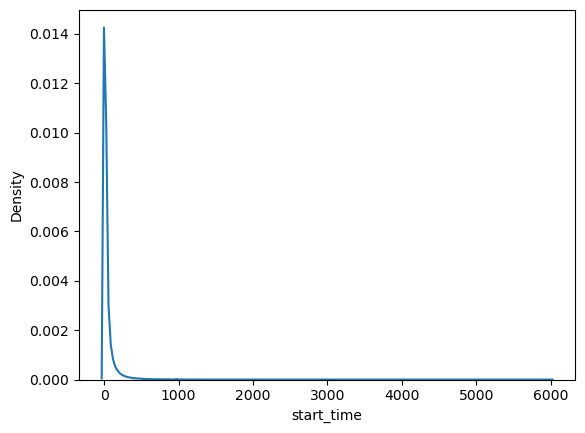

In [30]:
import seaborn as sns
sns.kdeplot(df_merged_final["start_time"])
plt.show()

In [35]:
df_melted = df_merged_final[["confirm_time", "start_time",	"step_1_time", "step_2_time", "step_3_time"]].melt(var_name="variable", value_name="value")
import plotly.express as px
fig = px.box(df_melted, 
             x='variable', 
             y='value',
             title='Box Plot Comparison',
             points='outliers',
             color='variable')

# Update layout
fig.update_layout(
    showlegend=False,
    yaxis_title='Values',
    xaxis_title='Variables',
    template='plotly_white'
)

fig.show()

In [38]:
df_merged_final["step_1_time"].head(30)

0       0.00
1      24.00
2       5.75
3      45.00
4        NaN
5      44.50
6       8.00
7      53.50
8        NaN
9        NaN
10     44.00
11     10.00
12       NaN
13     26.50
14     46.00
15      0.00
16     15.00
17      0.00
18      0.00
19       NaN
20       NaN
21     57.00
22     39.00
23    229.00
24       NaN
25       NaN
26       NaN
27     30.00
28     24.00
29     12.00
Name: step_1_time, dtype: float64